In [352]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import seaborn as sns
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline

pd.pandas.set_option('display.max_columns',None)
pd.pandas.set_option('display.max_rows',None)
import warnings
warnings.filterwarnings('ignore')
import missingno as msno

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/weather-dataset-rattle-package/weatherAUS.csv


In [353]:
df = pd.read_csv("../input/weather-dataset-rattle-package/weatherAUS.csv")
df_rain = df.copy()
df.sample(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
4163,2012-02-28,BadgerysCreek,21.7,30.3,0.0,NaN,NaN,WSW,31.0,N,W,6.0,9.0,84.0,53.0,1013.4,1011.2,NaN,NaN,24.0,29.6,No,Yes
72163,2014-02-03,Mildura,27.0,40.5,0.0,12.0,6.0,S,50.0,NNW,SW,13.0,22.0,21.0,16.0,1007.0,1007.7,7.0,7.0,32.6,38.1,No,No
126132,2015-07-27,SalmonGums,-0.6,16.5,0.0,NaN,NaN,NNW,30.0,N,N,17.0,17.0,81.0,43.0,NaN,NaN,NaN,NaN,9.4,16.0,No,No
70162,2016-11-07,Melbourne,14.6,25.9,0.0,7.0,5.1,N,59.0,N,WNW,30.0,13.0,47.0,61.0,1002.7,1003.5,7.0,7.0,19.6,16.8,No,No
20225,2015-01-14,NorahHead,21.4,34.9,1.8,NaN,NaN,NNE,41.0,N,WNW,20.0,9.0,78.0,36.0,999.6,997.0,NaN,NaN,26.4,34.1,Yes,No


In [354]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [355]:
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Date,145460,3436,2014-03-14,49,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Location,145460,49,Canberra,3436,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MinTemp,143975,NaN,NaN,NaN,12.194,6.39849,-8.5,7.6,12,16.9,33.9
MaxTemp,144199,NaN,NaN,NaN,23.2213,7.11905,-4.8,17.9,22.6,28.2,48.1
Rainfall,142199,NaN,NaN,NaN,2.36092,8.47806,0,0,0,0.8,371
Evaporation,82670,NaN,NaN,NaN,5.46823,4.1937,0,2.6,4.8,7.4,145
Sunshine,75625,NaN,NaN,NaN,7.61118,3.78548,0,4.8,8.4,10.6,14.5
WindGustDir,135134,16,W,9915,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WindGustSpeed,135197,NaN,NaN,NaN,40.0352,13.6071,6,31,39,48,135
WindDir9am,134894,16,N,11758,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Description of the variables:
__Date:__ Date

__Location:__ Location

__MinTemp:__

__MaxTemp:__

__Rainfall:__

__Evaporation:__

__Sunshine:__

__WindGustDir:__

__WindGustSpeed:__

__WindDir9am:__ Wind Direction at 9am

__WindDir3pm:__ Wind Direction at 3pm

__WindSpeed9am:__ Wind Speed at 9am

__WindSpeed3pm:__ Wind Speed at 3pm

__Humidity9am:__

__Humidity3pm:__

__Pressure9am:__

__Pressure3pm:__

__Cloud9am:__

__Cloud3pm:__

__Temp9am:__

__Temp3pm:__

__RainToday:__

__RainTomorrow:__

In [356]:
miss = df.isnull().sum().sort_values(ascending=False)
miss_per = (miss/len(df))*100
pd.DataFrame({'No. missing values': miss, '% of missing data': miss_per.values})

,No. missing values,% of missing data
Sunshine,69835,48.009762
Evaporation,62790,43.166506
Cloud3pm,59358,40.807095
Cloud9am,55888,38.421559
Pressure9am,15065,10.356799
Pressure3pm,15028,10.331363
WindDir9am,10566,7.263853
WindGustDir,10326,7.098859
WindGustSpeed,10263,7.055548
Humidity3pm,4507,3.098446


<AxesSubplot:>

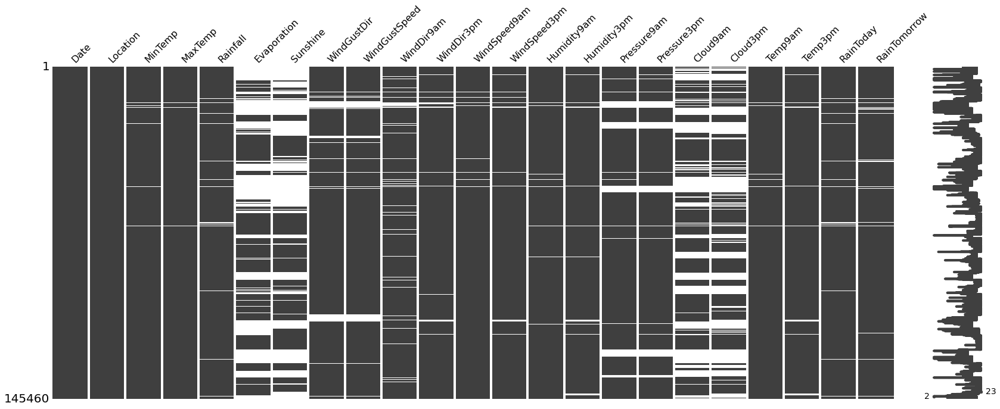

In [357]:
msno.matrix(df)

<AxesSubplot:>

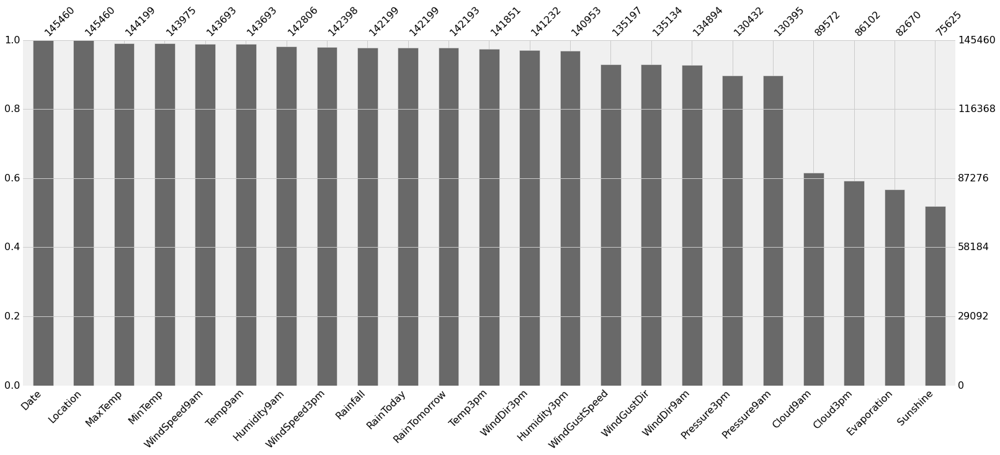

In [358]:
msno.bar(df, sort='descending')

<h2>First I will split the dataset into categorical and numerical.</h2>
I will get the columns name in order to work with them easily.

In [359]:
categorical = [i for i in df.columns if df[i].dtype=='object']
categorical

['Date',
 'Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [360]:
numerical = [i for i in df.columns if df[i].dtype=='float64']
numerical

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

In [361]:
df[categorical].isnull().sum()

Date                0
Location            0
WindGustDir     10326
WindDir9am      10566
WindDir3pm       4228
RainToday        3261
RainTomorrow     3267
dtype: int64

In [362]:
df['Date'] =pd.to_datetime(df['Date'])
df['Day'] = df['Date'].dt.day
df['Month'] = df['Date'].dt.month
df['Year'] = df['Date'].dt.year
df.sample(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
104220,2013-10-23,Nuriootpa,8.9,15.8,6.4,4.4,8.9,WSW,52.0,SSW,SW,24.0,28.0,80.0,51.0,1018.6,1018.8,7.0,NaN,10.5,14.3,Yes,No,23,10,2013
78940,2011-09-09,Watsonia,4.4,12.7,9.0,3.0,6.1,SSW,59.0,W,SSW,9.0,22.0,99.0,62.0,1015.3,1015.3,7.0,4.0,7.7,11.8,Yes,Yes,9,9,2011
137425,2012-09-15,AliceSprings,2.0,24.7,0.0,7.6,11.4,ESE,35.0,E,SSE,15.0,13.0,20.0,14.0,1022.8,1017.6,1.0,0.0,16.1,23.1,No,No,15,9,2012
21356,2009-08-26,NorfolkIsland,16.3,20.2,0.0,3.2,6.5,NNW,52.0,NW,NW,24.0,30.0,85.0,83.0,1019.2,1018.5,5.0,7.0,18.4,19.5,No,No,26,8,2009
29398,2015-05-10,Richmond,5.4,21.5,0.0,NaN,NaN,NW,57.0,NE,WNW,11.0,26.0,51.0,40.0,1011.6,1006.7,NaN,7.0,16.7,20.5,No,No,10,5,2015


In [363]:
df_rain['Date'] =pd.to_datetime(df_rain['Date'])
df_rain['Day'] = df_rain['Date'].dt.day
df_rain['Month'] = df_rain['Date'].dt.month
df_rain['Year'] = df_rain['Date'].dt.year
df_rain.sample(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
65219,2011-11-25,MelbourneAirport,12.7,22.4,0.0,6.2,4.0,NNE,28.0,E,N,9.0,11.0,70.0,64.0,1019.6,1016.5,2.0,7.0,17.8,21.1,No,Yes,25,11,2011
76020,2011-12-07,Portland,11.3,24.2,0.0,5.2,13.3,SE,24.0,E,S,11.0,15.0,75.0,55.0,1012.7,1010.5,1.0,2.0,17.5,22.0,No,No,7,12,2011
143607,2016-09-24,Katherine,26.1,34.9,0.0,5.6,NaN,NNW,30.0,NW,NNW,19.0,13.0,70.0,NaN,1011.4,1006.4,7.0,NaN,28.6,NaN,No,No,24,9,2016
122983,2015-03-01,Perth,17.3,31.2,0.0,10.0,8.5,ESE,43.0,E,SSW,9.0,19.0,51.0,40.0,1010.8,1007.3,2.0,5.0,23.9,28.3,No,No,1,3,2015
20503,2015-10-19,NorahHead,18.6,25.9,2.8,NaN,NaN,NE,44.0,ENE,NE,2.0,26.0,92.0,73.0,1026.4,1022.6,NaN,NaN,21.1,24.0,Yes,No,19,10,2015


# Distributions of Categorical Variables

## Location

In [364]:
df.Location.unique()

array(['Albury', 'BadgerysCreek', 'Cobar', 'CoffsHarbour', 'Moree',
       'Newcastle', 'NorahHead', 'NorfolkIsland', 'Penrith', 'Richmond',
       'Sydney', 'SydneyAirport', 'WaggaWagga', 'Williamtown',
       'Wollongong', 'Canberra', 'Tuggeranong', 'MountGinini', 'Ballarat',
       'Bendigo', 'Sale', 'MelbourneAirport', 'Melbourne', 'Mildura',
       'Nhil', 'Portland', 'Watsonia', 'Dartmoor', 'Brisbane', 'Cairns',
       'GoldCoast', 'Townsville', 'Adelaide', 'MountGambier', 'Nuriootpa',
       'Woomera', 'Albany', 'Witchcliffe', 'PearceRAAF', 'PerthAirport',
       'Perth', 'SalmonGums', 'Walpole', 'Hobart', 'Launceston',
       'AliceSprings', 'Darwin', 'Katherine', 'Uluru'], dtype=object)

In [365]:
df.Location.nunique()

49

Unique values in 'Location' is as seen above 49

In [366]:
df.Location.value_counts()

Canberra            3436
Sydney              3344
Perth               3193
Darwin              3193
Brisbane            3193
Melbourne           3193
Hobart              3193
Adelaide            3193
Albany              3040
Bendigo             3040
Cairns              3040
Albury              3040
Wollongong          3040
Townsville          3040
MountGambier        3040
MountGinini         3040
AliceSprings        3040
Launceston          3040
Ballarat            3040
GoldCoast           3040
Tuggeranong         3039
Penrith             3039
Newcastle           3039
Portland            3009
WaggaWagga          3009
Woomera             3009
Cobar               3009
BadgerysCreek       3009
PerthAirport        3009
Mildura             3009
Witchcliffe         3009
Moree               3009
MelbourneAirport    3009
Williamtown         3009
SydneyAirport       3009
CoffsHarbour        3009
Nuriootpa           3009
Watsonia            3009
Dartmoor            3009
PearceRAAF          3009


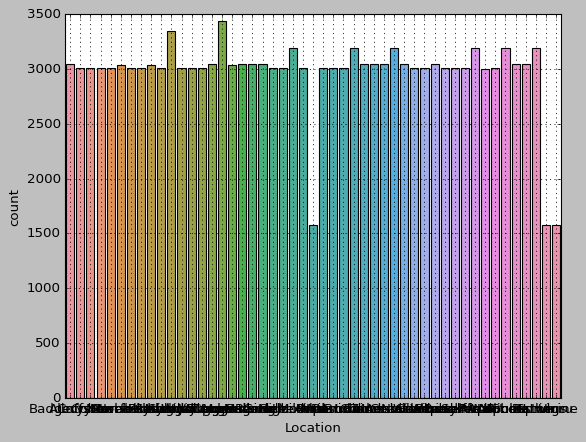

In [367]:
plt.style.use("classic")
sns.countplot(data=df, x="Location")
plt.grid(linewidth = 0.7)
plt.show()

In [368]:
fig_2 = px.histogram(df_rain, x="Location")
fig_2.show()

## Date

In [369]:
fig_1 = px.histogram(df, x="Date")
fig_1.show()

## WindGustdir

In [370]:
df.WindGustDir.unique()

array(['W', 'WNW', 'WSW', 'NE', 'NNW', 'N', 'NNE', 'SW', nan, 'ENE',
       'SSE', 'S', 'NW', 'SE', 'ESE', 'E', 'SSW'], dtype=object)

In [371]:
df.WindGustDir.value_counts()

W      9915
SE     9418
N      9313
SSE    9216
E      9181
S      9168
WSW    9069
SW     8967
SSW    8736
WNW    8252
NW     8122
ENE    8104
ESE    7372
NE     7133
NNW    6620
NNE    6548
Name: WindGustDir, dtype: int64

In [372]:
df.WindGustDir.nunique() 

16

I will replace missing values with the most frequent values.

In [373]:
df['WindGustDir'].fillna(df['WindGustDir'].mode()[0], inplace=True)

In [374]:
df.WindGustDir.isnull().sum()

0

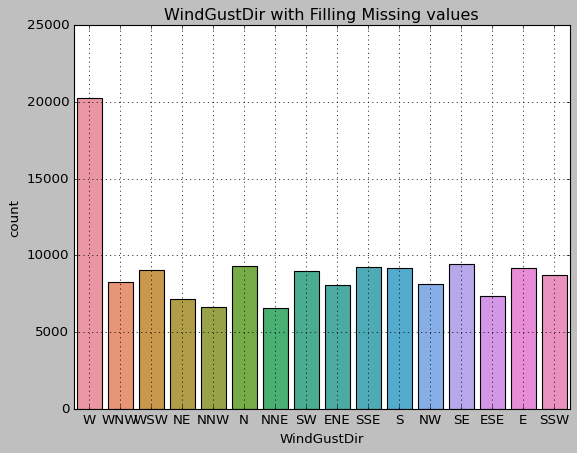

In [375]:
plt.style.use("classic")
sns.countplot(data=df, x="WindGustDir")
plt.grid(linewidth = 0.7)
plt.title('WindGustDir with Filling Missing values')
plt.show()

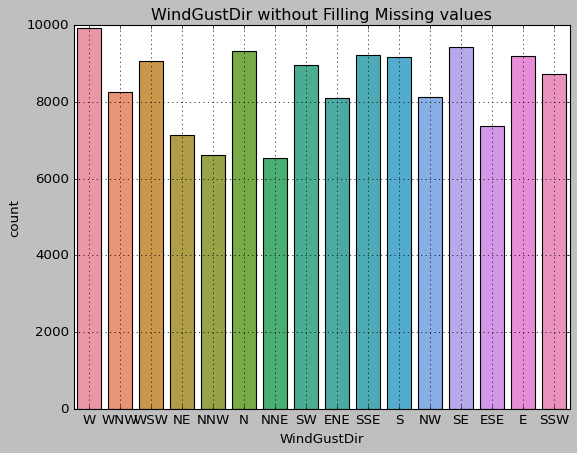

In [376]:
plt.style.use("classic")
sns.countplot(data=df_rain, x="WindGustDir")
plt.grid(linewidth = 0.7)
plt.title('WindGustDir without Filling Missing values')
plt.show()

In [377]:
fig_3 = px.histogram(df, x="WindGustDir", title="WindGustDir with Filling Missing values")
fig_3.show()

In [378]:
fig_3_nonmissing = px.histogram(df_rain, x="WindGustDir", title="WindGustDir without Filling Missing values")
fig_3_nonmissing.show()

## WindDir9am

In [379]:
df.WindDir9am.unique()

array(['W', 'NNW', 'SE', 'ENE', 'SW', 'SSE', 'S', 'NE', nan, 'SSW', 'N',
       'WSW', 'ESE', 'E', 'NW', 'WNW', 'NNE'], dtype=object)

In [380]:
df.WindDir9am.value_counts()

N      11758
SE      9287
E       9176
SSE     9112
NW      8749
S       8659
W       8459
SW      8423
NNE     8129
NNW     7980
ENE     7836
NE      7671
ESE     7630
SSW     7587
WNW     7414
WSW     7024
Name: WindDir9am, dtype: int64

Replacing the missing values with the most frequent values.


In [381]:
df['WindDir9am'].fillna(df['WindDir9am'].mode()[0], inplace=True)

In [382]:
df.WindDir9am.isnull().sum()

0

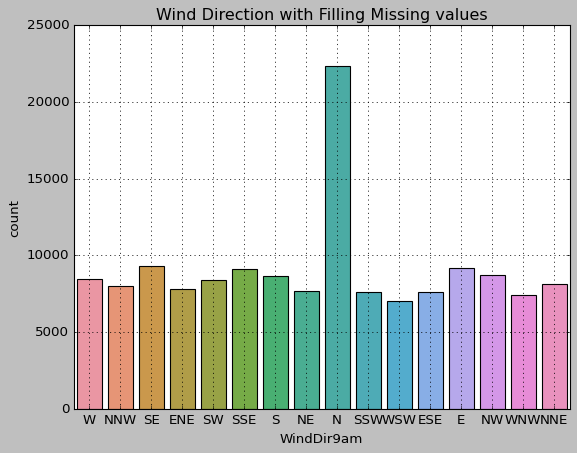

In [383]:
plt.style.use("classic")
sns.countplot(data=df, x="WindDir9am")
plt.grid(linewidth = 0.7)
plt.title('Wind Direction with Filling Missing values')
plt.show()

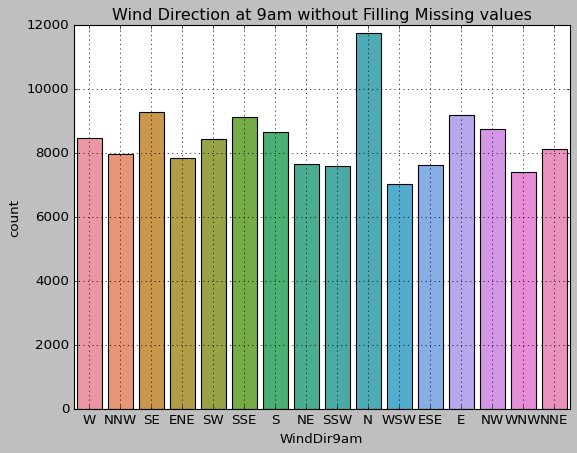

In [384]:
plt.style.use("classic")
sns.countplot(data=df_rain, x="WindDir9am")
plt.grid(linewidth = 0.7)
plt.title('Wind Direction at 9am without Filling Missing values')
plt.show()

In [385]:
fig_4 = px.histogram(df, x="WindDir9am", title='Wind Direction at 9am with Filling Missing values')
fig_4.show()

In [386]:
fig_4_nonmissing = px.histogram(df_rain, x="WindDir9am", title='Wind Direction at 9am without Filling Missing values')
fig_4_nonmissing.show()

## WindDir3pm

In [387]:
fig_5 = px.histogram(df, x="WindDir3pm")
fig_5.show()

## RainToday

In [388]:
fig_6 = px.histogram(df, x="RainToday")
fig_6.show()

## RainTomorrow

In [389]:
fig_7 = px.histogram(df, x="RainTomorrow")
fig_7.show()

# Distributions of Numerical Variables

In [390]:
df[numerical].isnull().sum()

MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustSpeed    10263
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
dtype: int64

I will replace missing values with median first and I will drop it in another copy of th dataframe and work on it too.

In [391]:
for i in df:
    if df[i].dtype=='float64':
        df[i].replace(to_replace=np.nan, value=df[i].median(), inplace=True)
    else:
        continue

In [392]:
df[numerical].isnull().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
dtype: int64

In [393]:
dropped = df_rain.dropna(inplace=True)

In [394]:
df[numerical].isnull().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
dtype: int64

In [395]:
df_rain[numerical].isnull().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
dtype: int64

## **Distribution Plot** <a id='4.2' ></a>

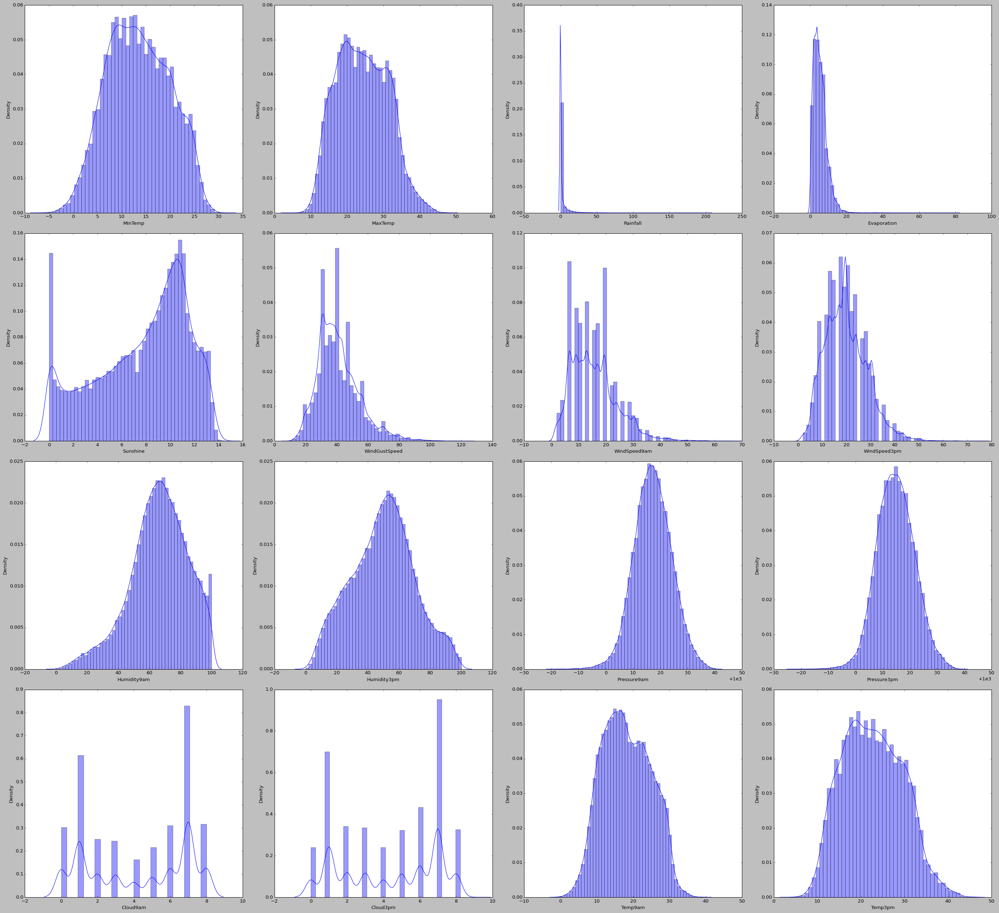

In [396]:
#  plot Numerical Data
a = 4  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
fig = plt.figure(figsize=(35,32))
for i in df_rain:
    if df_rain[i].dtype=='float64':
        plt.subplot(a, b, c)
        sns.distplot(df_rain[i])
        c = c+1
    else:
        continue
plt.tight_layout()
plt.show()       

## MinTemp

In [397]:
fig_8 = px.histogram(df, x="MinTemp")
fig_8.show()

In [398]:
fig_9 = px.histogram(df_rain, x="MinTemp")
fig_9.show()

In [399]:
fig_10 = px.histogram(df_rain, x="MinTemp", color='RainToday')
fig_10.show()

In [400]:
fig_11 = px.histogram(df_rain, x="MinTemp", color='RainTomorrow')
fig_11.show()

## MaxTemp

In [401]:
fig_12 = px.histogram(df, x="MaxTemp")
fig_12.show()

In [402]:
fig_13 = px.histogram(df_rain, x="MaxTemp")
fig_13.show()

In [403]:
fig_14 = px.histogram(df_rain, x="MaxTemp", color='RainToday')
fig_14.show()

In [404]:
fig_15 = px.histogram(df_rain, x="MaxTemp", color='RainTomorrow')
fig_15.show()

## RainFall

In [405]:
fig_16 = px.histogram(df, x="MaxTemp")
fig_16.show()

In [406]:
fig_17 = px.histogram(df_rain, x="MaxTemp")
fig_17.show()

In [407]:
fig_18 = px.histogram(df_rain, x="MaxTemp", color='RainToday')
fig_18.show()

In [408]:
fig_19 = px.histogram(df_rain, x="MaxTemp", color='RainTomorrow')
fig_19.show()

## Evaporation

In [409]:
fig_20 = px.histogram(df, x="Evaporation")
fig_20.show()

In [410]:
fig_21 = px.histogram(df_rain, x="Evaporation")
fig_21.show()

In [411]:
fig_22 = px.histogram(df_rain, x="Evaporation", color='RainToday')
fig_22.show()

In [412]:
fig_23 = px.histogram(df_rain, x="Evaporation", color='RainTomorrow')
fig_23.show()

## Sunshine

In [413]:
fig_25 = px.histogram(df, x="Sunshine")
fig_25.show()

In [414]:
fig_26 = px.histogram(df_rain, x="Sunshine")
fig_26.show()

In [415]:
fig_27 = px.histogram(df_rain, x="Sunshine", color='RainToday')
fig_27.show()

In [416]:
fig_28 = px.histogram(df_rain, x="Sunshine", color='RainTomorrow')
fig_28.show()

## WindGustSpeed

In [417]:
fig_29 = px.histogram(df, x="WindGustSpeed")
fig_29.show()

In [418]:
fig_30 = px.histogram(df_rain, x="WindGustSpeed")
fig_30.show()

In [419]:
fig_31 = px.histogram(df_rain, x="WindGustSpeed", color='RainToday')
fig_31.show()

In [420]:
fig_32 = px.histogram(df_rain, x="WindGustSpeed", color='RainTomorrow')
fig_32.show()

## WindSpeed9am

In [421]:
fig_33 = px.histogram(df, x="WindSpeed9am")
fig_33.show()

In [422]:
fig_34 = px.histogram(df_rain, x="WindSpeed9am")
fig_34.show()

In [423]:
fig_35 = px.histogram(df_rain, x="WindSpeed9am", color='RainToday')
fig_35.show()

In [424]:
fig_36 = px.histogram(df_rain, x="WindSpeed9am", color='RainTomorrow')
fig_36.show()

## WindSpeed3pm

In [425]:
fig_37 = px.histogram(df, x="WindSpeed3pm")
fig_37.show()

In [426]:
fig_38 = px.histogram(df_rain, x="WindSpeed3pm")
fig_38.show()

In [427]:
fig_39 = px.histogram(df_rain, x="WindSpeed3pm", color='RainToday')
fig_39.show()

In [428]:
fig_40 = px.histogram(df_rain, x="WindSpeed3pm", color='RainTomorrow')
fig_40.show()

## Humidity9am

In [429]:
fig_41= px.histogram(df, x="Humidity9am")
fig_41.show()

In [430]:
fig_42 = px.histogram(df_rain, x="Humidity9am")
fig_42.show()

In [431]:
fig_43 = px.histogram(df_rain, x="Humidity9am", color='RainToday')
fig_43.show()

In [432]:
fig_44 = px.histogram(df_rain, x="Humidity9am", color='RainTomorrow')
fig_44.show()

## Humidfity3pm

In [433]:
fig_45 = px.histogram(df, x="Humidity3pm")
fig_45.show()

In [434]:
fig_46 = px.histogram(df_rain, x="Humidity3pm")
fig_46.show()

In [435]:
fig_47 = px.histogram(df_rain, x="Humidity3pm", color='RainToday')
fig_47.show()

In [436]:
fig_48 = px.histogram(df_rain, x="Humidity3pm", color='RainTomorrow')
fig_48.show()

## Pressure9am

In [437]:
fig_49 = px.histogram(df, x="Pressure9am")
fig_49.show()

In [438]:
fig_50 = px.histogram(df_rain, x="Pressure9am")
fig_50.show()

In [439]:
fig_51 = px.histogram(df_rain, x="Pressure9am", color='RainToday')
fig_51.show()

In [440]:
fig_52 = px.histogram(df_rain, x="Pressure9am", color='RainTomorrow')
fig_52.show()

## Pressure3pm

In [441]:
fig_53 = px.histogram(df, x="Pressure3pm")
fig_53.show()

In [442]:
fig_54 = px.histogram(df_rain, x="Pressure3pm")
fig_54.show()

In [443]:
fig_55 = px.histogram(df_rain, x="Pressure3pm", color='RainToday')
fig_55.show()

In [444]:
fig_56 = px.histogram(df_rain, x="Pressure3pm", color='RainTomorrow')
fig_56.show()

## Cloud9am

In [445]:
fig_57 = px.histogram(df, x="Cloud9am")
fig_57.show()

In [446]:
fig_58 = px.histogram(df_rain, x="Cloud9am")
fig_58.show()

In [447]:
fig_59 = px.histogram(df_rain, x="Cloud9am", color='RainToday')
fig_59.show()

In [448]:
fig_60 = px.histogram(df_rain, x="Cloud9am", color='RainTomorrow')
fig_60.show()

## Cloud3pm

In [449]:
fig_61= px.histogram(df, x="Cloud9am")
fig_61.show()

In [450]:
fig_62 = px.histogram(df_rain, x="Cloud9am")
fig_62.show()

In [451]:
fig_63 = px.histogram(df_rain, x="Cloud9am", color='RainToday')
fig_63.show()

In [452]:
fig_64 = px.histogram(df_rain, x="Cloud9am", color='RainTomorrow')
fig_64.show()

## Temp9am

In [453]:
fig_65 = px.histogram(df, x="Temp9am")
fig_65.show()

In [454]:
fig_66 = px.histogram(df_rain, x="Temp9am")
fig_66.show()

In [455]:
fig_67 = px.histogram(df_rain, x="Temp9am", color='RainToday')
fig_67.show()

In [456]:
fig_68 = px.histogram(df_rain, x="Temp9am", color='RainTomorrow')
fig_68.show()

## Temp3pm

In [457]:
fig_69 = px.histogram(df, x="Temp3pm")
fig_69.show()

In [458]:
fig_70 = px.histogram(df_rain, x="Temp3pm")
fig_70.show()

In [459]:
fig_71 = px.histogram(df_rain, x="Temp3pm", color='RainToday')
fig_71.show()

In [460]:
fig_72 = px.histogram(df_rain, x="Temp3pm", color='RainTomorrow')
fig_72.show()

## **Heat Map Correlation** <a id='4.1' ></a>

<AxesSubplot:>

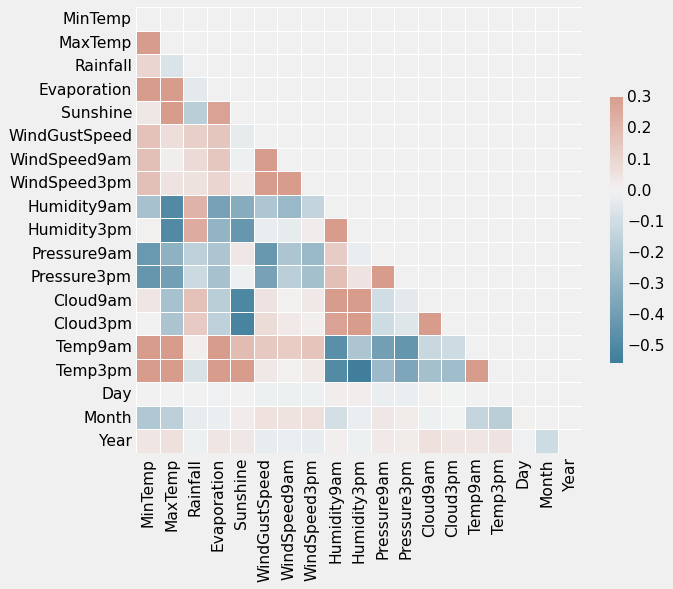

In [461]:
 plt.style.use('fivethirtyeight')
# Compute the correlation matrix
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(8, 8))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})

<AxesSubplot:>

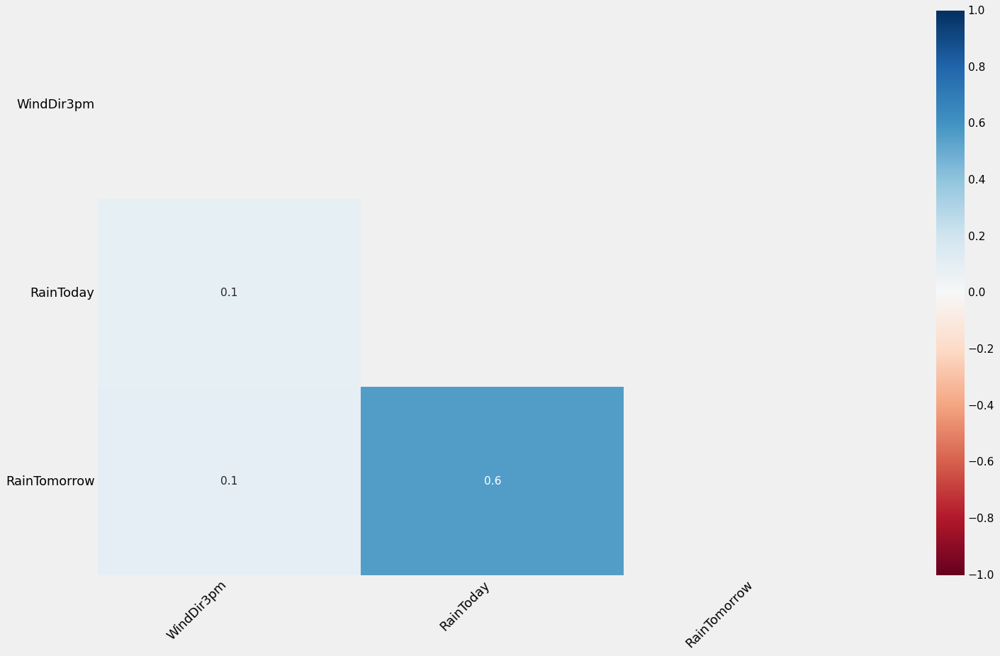

In [462]:
msno.heatmap(df)

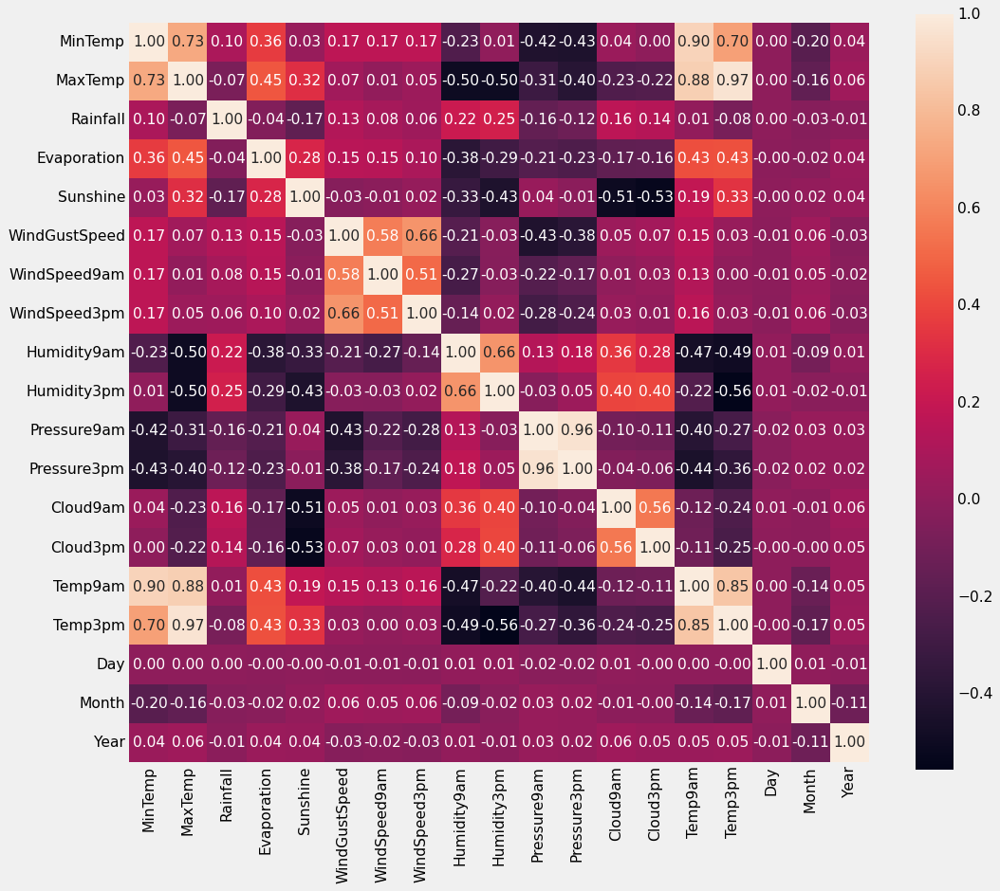

In [463]:
plt.figure(figsize=(14,12))
ax = sns.heatmap(corr, square=True, annot=True, fmt='.2f')
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)          
plt.show()

## Scatter matrix and/or OLS Scatter Plot for numerical variables

In [464]:
df_raintoday_meaned = df_rain.groupby(["Year", "Month", "RainToday"])[numerical].mean().reset_index()
df_raintomorrow_meaned = df_rain.groupby(["Year", "Month", "RainTomorrow"])[numerical].mean().reset_index()

In [465]:
cols = []
for i in numerical:
    for j in numerical:
        if i != j:
            cols.append((i,j))

In [468]:
random_idx = np.random.randint(len(cols), size=10)
random_idx

array([ 83,  43, 208, 144, 233, 126, 206, 228,  77,  80])

In [471]:
for idx in random_idx:
    fig = px.scatter(df_raintoday_meaned, x=cols[idx][0], y=cols[idx][1],title=f"Scatterplot of {cols[idx]}",
                     trendline="ols",
                     color='RainToday',
                     trendline_color_override="green")
    fig.show()

In [475]:
for idx in random_idx:
    fig = px.scatter(df_raintomorrow_meaned, x=cols[idx][0], y=cols[idx][1],title=f"Scatterplot of {cols[idx]}",
                     trendline="ols",
                     color='RainTomorrow',
                     trendline_color_override="green")
    fig.show()

In [486]:
df_1 = df_raintoday_meaned.groupby(["Year", "RainToday"])[numerical].mean().reset_index()
df_1.sample(5)

,Year,RainToday,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
1,2007,Yes,12.725595,22.992857,10.817857,4.984524,7.383333,45.255952,11.767857,16.000000,75.720238,52.827381,1013.432143,1011.719643,5.214286,5.089286,16.030357,21.391071
9,2011,Yes,14.306220,21.449240,10.545252,3.785359,5.196068,43.854513,16.826290,21.181420,80.342574,65.921605,1014.140786,1012.789340,5.986119,5.764379,17.217587,19.911400
13,2013,Yes,13.787740,21.235826,8.911960,3.932282,5.727431,45.555559,17.819083,21.953181,78.452310,63.542078,1014.785481,1013.436540,5.657677,5.537499,16.935098,19.674326
0,2007,No,12.393478,25.890275,0.073227,6.344622,8.430892,39.359268,8.740275,17.107551,66.562929,42.456522,1018.235355,1015.128719,4.543478,4.847826,17.746110,24.216476
21,2017,Yes,15.516817,22.428521,11.757151,4.207708,5.000996,40.933054,14.668443,17.691501,80.630841,64.718160,1016.804287,1015.652472,5.883268,5.573552,18.072340,20.955189


In [488]:
df_2 = df_raintoday_meaned.groupby(["Month", "RainToday"])[numerical].mean().reset_index()
df_2.sample(5)

,Month,RainToday,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
4,3,No,15.895739,27.969509,0.070258,6.632867,8.450424,39.517466,13.959743,18.533972,65.103678,43.647395,1017.361947,1014.842726,3.764353,3.923250,20.235498,26.431014
12,7,No,8.350776,18.989994,0.091528,3.067475,6.822044,37.805177,14.547949,18.205477,70.140051,50.290559,1021.363477,1018.441399,3.704436,4.082396,12.591129,17.912444
11,6,Yes,10.109254,16.227947,9.039641,1.876069,3.538108,41.394333,15.346660,18.057353,85.087572,70.678006,1018.824223,1017.623854,6.003636,5.907086,12.428141,14.993718
0,1,No,17.803331,30.529936,0.052886,9.136642,9.908566,43.460330,15.642744,20.374117,56.631404,41.033692,1013.108573,1010.714125,3.843617,3.642436,23.126778,28.626350
6,4,No,12.888767,24.730968,0.064550,4.723971,7.842120,35.787434,13.203594,17.033668,65.619662,45.969896,1020.193145,1017.226466,3.798748,4.213771,18.216884,23.434180


In [487]:
for i in numerical:
    fig = px.line(df_1, x="Year", y=i, title=f"Line Plot of {i}", color='RainToday')
    fig.show()

In [490]:
for i in numerical:
    fig = px.line(df_2, x="Month", y=i, title=f"Line Plot of {i}", color='RainToday')
    fig.show()

In [491]:
df3 = df_rain[df_rain.RainToday=='Yes'].groupby('WindGustDir')[numerical].agg('mean').reset_index()
df4 = df_rain[df_rain.RainToday=='No'].groupby('WindGustDir')[numerical].agg('mean').reset_index()

In [492]:
import plotly.graph_objects as go

In [493]:
categories = df4.WindGustDir.unique()

for i in numerical:
    fig = go.Figure()

    fig.add_trace(go.Scatterpolar(
          r=df3[i],
          theta=categories,
          fill='toself',
          name='Product A'
    ))
    fig.add_trace(go.Scatterpolar(
          r=df4[i],
          theta=categories,
          fill='toself',
          name='Product B'
    ))

    fig.update_layout(
      polar=dict(
        radialaxis=dict(
          visible=True,
          range=[min(df3[i].min(),df4[i].min()),
                 max(df3[i].max(),df4[i].max())]
        )),
      title={
        'text': f"Radarplot of {i}",
        'y':0.9,'x':0.5,
        'xanchor': 'center','yanchor': 'top'},
      showlegend=False
    )

    fig.show()